In [2]:
import sys
  
# setting path
sys.path.append('../')

In [3]:
import os
import time
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import librosa
import IPython.display
from pydub import AudioSegment

from utils.audio import Audio
from utils.hparams import HParam

import torch
import torch.nn as nn

from utils.power_law_loss import PowerLawCompLoss
from model.model import VoiceFilter
from model.embedder import SpeechEmbedder
from mir_eval.separation import bss_eval_sources
from datasets.GGSpeakerIDDataset import create_dataset

In [4]:
hp = HParam("../config.yaml")

../utils/hparams.py:18: YAMLLoadWarning: calling yaml.load_all() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  for doc in docs:


# Preparation

In [5]:
def getaudio(sample, base_fix="../"):
    sr = hp.audio.sample_rate
    s1_dvec = base_fix+sample["embedding_utterance_path"]
    s1_target = base_fix+sample["clean_utterance_path"]
    s2 = base_fix+sample["interference_utterance_path"]

    d, _ = librosa.load(s1_dvec, sr=sr)
    w1, _ = librosa.load(s1_target, sr=sr)
    w2, _ = librosa.load(s2, sr=sr)

    # d, _ = librosa.effects.trim(d, top_db=20)
    w1, _ = librosa.effects.trim(w1, top_db=20)
    w2, _ = librosa.effects.trim(w2, top_db=20)

    # Mix 2 audio, then trim to match clean audio length
    mixed = w1 + np.pad(w2[:w1.shape[0]], (0, max(0, w1.shape[0]-w2.shape[0])), constant_values=0)

    # plt.plot(w1)
    # plt.show()
    
    # plt.plot(w2)
    # plt.show()
    
    # plt.plot(mixed)
    # plt.show()
    
    
    norm = np.max(np.abs(mixed)) * 1.1
    w1, w2, mixed = w1/norm, w2/norm, mixed/norm
    
    return d, w1, mixed, w2

In [6]:
dataset_df = create_dataset(hp, dataset_name="test", base_dir="../").data

In [7]:
with open("GGSpeaker_test.json", "r") as f:
    test_result = json.load(f)

for key in list(test_result.keys()):
    test_result[key] = np.array(test_result[key])
    if "losses" in key:
        test_result[key] = np.mean(test_result[key])
    else:
        dataset_df[key] = test_result[key]
        if "sdrs" in key and "before" not in key and "improve" not in key:
            dataset_df[key+"_improve"] = dataset_df[key] - dataset_df["sdrs_before"]

In [8]:
def statistic(arr):
    print("Mean: ", arr.mean())
    print("Median: ", np.median(arr))
    _ = plt.hist(arr, bins=100)
    plt.show()

In [9]:
device = "cpu"

embedder_pt = torch.load("../embedder.pt", device)
embedder = SpeechEmbedder(hp)
embedder.load_state_dict(embedder_pt)
embedder.eval()

# Power-law compressed loss
model = VoiceFilter(hp)
checkpoint = torch.load("../chkpt/powlaw_loss/chkpt_168000.pt", device)
model.load_state_dict(checkpoint['model'])
model.eval()

# Power-law compressed loss fine-tune
model_f = VoiceFilter(hp)
checkpoint = torch.load("../chkpt/powlaw_loss_finetune/chkpt_178000.pt", device)
model_f.load_state_dict(checkpoint['model'])
model_f.eval()


# First try (MSE loss)
model_0 = VoiceFilter(hp)
checkpoint = torch.load("../chkpt/new_dataloader/chkpt_108000.pt", device)
model_0.load_state_dict(checkpoint['model'])
model_0.eval()

# MSE ver 48k (ms.Tam)
model_t = VoiceFilter(hp)
checkpoint = torch.load("../chkpt/mstam_mse/chkpt_48000.pt", device)
model_t.load_state_dict(checkpoint['model'])
model_t.eval()

pass

In [10]:
audio = Audio(hp)

In [11]:
def preprocess(d, mixed):
    dvec_mel = audio.get_mel(d)
    dvec_mel = torch.from_numpy(dvec_mel).float()

    mixed_mag, mixed_phase = audio.wav2spec(mixed)
    mixed_stft = audio.stft(mixed).T
    
    return dvec_mel, torch.from_numpy(mixed_mag), torch.from_numpy(mixed_phase), torch.from_numpy(mixed_stft)

In [12]:
def powerlaw_inference(model, d, mixed):
    criterion = PowerLawCompLoss()
    
    dvec_mel, mixed_mag, mixed_phase, mixed_stft = preprocess(d, mixed)
    
    dvec = embedder(dvec_mel)
    dvec = dvec.unsqueeze(0)
    mixed_stft = mixed_stft.unsqueeze(0)
    
    est_mask = model(torch.pow(mixed_stft.abs(), 0.3), dvec)
    est_mask = torch.pow(est_mask, 10/3)
    est_stft = mixed_stft * est_mask

    mixed_stft = mixed_stft[0].numpy()
    est_stft = est_stft[0].detach().numpy()
    est_wav = audio._istft(est_stft.T, length=mixed.shape[0])

    return est_wav

In [13]:
def mse_inference(model, d, mixed):
    criterion = nn.MSELoss()
    
    dvec_mel, mixed_mag, mixed_phase, mixed_stft = preprocess(d, mixed)
    
    dvec = embedder(dvec_mel)
    dvec = dvec.unsqueeze(0)
    mixed_mag = mixed_mag.unsqueeze(0)
    
    est_mask = model(mixed_mag, dvec)
    est_mag = mixed_mag * est_mask
    
    mixed_mag = mixed_mag[0].numpy()
    est_mag = est_mag[0].detach().numpy()
    mixed_phase = mixed_phase.numpy()
    est_wav = audio.spec2wav(est_mag, mixed_phase, length=mixed.shape[0])

    return est_wav

In [17]:
def inference_detail(sample, *, save:bool):
    def getcurrent():
        return time.strftime("%Y%m%d_%H%M%SUTC", time.localtime())
    
    def export_audio(w, fname):
        AudioSegment(
            IPython.display.Audio(w, rate=16000).data,
            frame_rate=16000,
            sample_width=2,
            channels=1
        ).export(
            os.path.join(folder, fname),
            format="wav"
        )
    
    d, w1, mix, w2 = getaudio(sample)
    IPython.display.display(sample)
    print("Mixed audio")
    IPython.display.display(IPython.display.Audio(mix, rate=16000, normalize=False))
    print("Target audio")
    IPython.display.display(IPython.display.Audio(w1, rate=16000, normalize=False))
    print("Ref audio")
    IPython.display.display(IPython.display.Audio(d, rate=16000, normalize=False))
    print("Power-law predict")
    p_pred = powerlaw_inference(model, d, mix)
    IPython.display.display(IPython.display.Audio(p_pred, rate=16000, normalize=False))
    print("Power-law fine-tune predict")
    f_pred = powerlaw_inference(model_f, d, mix)
    IPython.display.display(IPython.display.Audio(f_pred, rate=16000, normalize=False))
    print("MSE predict")
    m0_pred = mse_inference(model_0, d, mix)
    IPython.display.display(IPython.display.Audio(m0_pred, rate=16000, normalize=False))
    print("MSE ms.T predict")
    t_pred = mse_inference(model_t, d, mix)
    IPython.display.display(IPython.display.Audio(t_pred, rate=16000, normalize=False))
    
    # Save inference result to folder
    if save:
        folder = getcurrent()
        os.mkdir(folder)
        with open(os.path.join(folder, "log.txt"), "w") as f:
            for key in sample.keys():
                f.write(key + ':\t' + str(sample[key])+"\n")
                
        export_audio(mix, "mixed_audio.wav")
        export_audio(w1, "target_audio.wav")
        export_audio(d, "dvec_audio.wav")
        export_audio(w2, "interf_audio.wav")
        export_audio(p_pred, "pred_powlaw_audio.wav")
        export_audio(f_pred, "pred_finetune_audio.wav")
        export_audio(m0_pred, "pred_mse_audio.wav")
#        export_audio(t_pred, "pred_mset_audio.wav")
        
    return d, w1, mix, p_pred, f_pred, m0_pred, t_pred

In [15]:
def sample_detail(sample):
    d, w1, mix, w2 = getaudio(sample)
    IPython.display.display(sample)
    print("Mixed audio")
    IPython.display.display(IPython.display.Audio(mix, rate=16000, normalize=False))
    print("Target audio")
    IPython.display.display(IPython.display.Audio(w1, rate=16000, normalize=False))
    print("Target audio normalize")
    IPython.display.display(IPython.display.Audio(w1, rate=16000, normalize=True))
    print("Ref audio")
    IPython.display.display(IPython.display.Audio(d, rate=16000, normalize=False))
    print("Interference audio")
    IPython.display.display(IPython.display.Audio(w2, rate=16000, normalize=False))

# Main

In [27]:
inference_detail(dataset_df.iloc[9], save=True)

clean_utterance_path           datasets/LibriSpeech/dev-other/1701/141760/170...
embedding_utterance_path       datasets/LibriSpeech/dev-other/1701/141759/170...
interference_utterance_path    datasets/LibriSpeech/dev-clean/251/136532/251-...
sdrs_before                                                            -7.385882
sdrs_p                                                                  0.126728
sdrs_p_improve                                                           7.51261
sdrs_0                                                                 -2.655614
sdrs_0_improve                                                          4.730268
sdrs_t                                                                 -5.228379
sdrs_t_improve                                                          2.157503
sdrs_f                                                                  0.919807
sdrs_f_improve                                                          8.305689
Name: 9, dtype: object

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


(array([0.00408936, 0.00335693, 0.00259399, ..., 0.0022583 , 0.00262451,
        0.00228882], dtype=float32),
 array([0.00564318, 0.00546346, 0.00539157, ..., 0.00553535, 0.00618234,
        0.00452892], dtype=float32),
 array([0.00621828, 0.00618234, 0.00589479, ..., 0.00744037, 0.0084468 ,
        0.00675744], dtype=float32),
 array([0.00424814, 0.0042214 , 0.00410022, ..., 0.00505402, 0.00570997,
        0.00456845], dtype=float32),
 array([0.00325665, 0.00323502, 0.00314511, ..., 0.00385277, 0.00430709,
        0.00350813], dtype=float32),
 array([0.00445847, 0.00447852, 0.00432959, ..., 0.00457138, 0.0052639 ,
        0.00406836], dtype=float32),
 array([0.00406009, 0.00407082, 0.00388764, ..., 0.0051165 , 0.00575152,
        0.00464417], dtype=float32))

## Đánh giá input

Phân phối chất lượng input (SDR)

Mean:  1.28942228324775
Median:  1.0129912350476389


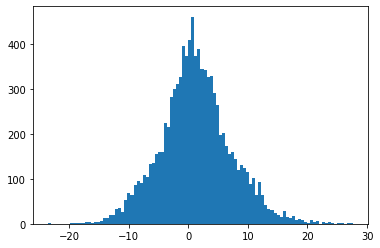

In [19]:
statistic(dataset_df["sdrs_before"])

Nghe thử 1 audio chất lượng kém nhất

In [20]:
sample_detail(dataset_df[dataset_df["sdrs_before"] < -15].iloc[0])

clean_utterance_path           datasets/LibriSpeech/dev-clean/3081/166546/308...
embedding_utterance_path       datasets/LibriSpeech/dev-clean/3081/166546/308...
interference_utterance_path    datasets/LibriSpeech/dev-clean/5536/43363/5536...
sdrs_before                                                           -17.062285
sdrs_p                                                                  2.181204
sdrs_p_improve                                                         19.243489
sdrs_0                                                                  2.104759
sdrs_0_improve                                                         19.167043
sdrs_t                                                                 -1.950057
sdrs_t_improve                                                         15.112227
sdrs_f                                                                  0.652571
sdrs_f_improve                                                         17.714855
Name: 195, dtype: object

Mixed audio


Target audio


Target audio normalize


Ref audio


Interference audio


Nghe thử 1 audio chất lượng trung bình

In [21]:
sample_detail(dataset_df[(dataset_df["sdrs_before"] < 0.5) & (dataset_df["sdrs_before"] > -0.5)].iloc[0])

clean_utterance_path           datasets/LibriSpeech/dev-other/1686/142278/168...
embedding_utterance_path       datasets/LibriSpeech/dev-other/1686/142278/168...
interference_utterance_path    datasets/LibriSpeech/dev-other/3915/98647/3915...
sdrs_before                                                             0.158648
sdrs_p                                                                  5.780681
sdrs_p_improve                                                          5.622034
sdrs_0                                                                  0.072766
sdrs_0_improve                                                         -0.085882
sdrs_t                                                                  0.552614
sdrs_t_improve                                                          0.393966
sdrs_f                                                                  4.312783
sdrs_f_improve                                                          4.154135
Name: 35, dtype: object

Mixed audio


Target audio


Target audio normalize


Ref audio


Interference audio


Nghe thử 1 audio chất lượng tốt sẵn

In [22]:
sample_detail(dataset_df[dataset_df["sdrs_before"] > 10].iloc[0])

clean_utterance_path           datasets/LibriSpeech/dev-other/7601/101619/760...
embedding_utterance_path       datasets/LibriSpeech/dev-other/7601/175351/760...
interference_utterance_path    datasets/LibriSpeech/dev-other/1686/142278/168...
sdrs_before                                                            11.212418
sdrs_p                                                                 16.442814
sdrs_p_improve                                                          5.230396
sdrs_0                                                                 12.440577
sdrs_0_improve                                                          1.228158
sdrs_t                                                                 11.119222
sdrs_t_improve                                                         -0.093196
sdrs_f                                                                 14.171236
sdrs_f_improve                                                          2.958818
Name: 12, dtype: object

Mixed audio


Target audio


Target audio normalize


Ref audio


Interference audio


Nghe thử 1 audio chất lượng quá tốt (outlier)

In [25]:
sample_detail(dataset_df[dataset_df["sdrs_before"] > 25].iloc[0])

clean_utterance_path           datasets/LibriSpeech/dev-clean/422/122949/422-...
embedding_utterance_path       datasets/LibriSpeech/dev-clean/422/122949/422-...
interference_utterance_path    datasets/LibriSpeech/dev-clean/3081/166546/308...
sdrs_before                                                            25.100002
sdrs_p                                                                  5.920591
sdrs_p_improve                                                        -19.179411
sdrs_0                                                                 -3.503165
sdrs_0_improve                                                        -28.603166
sdrs_t                                                                  4.009267
sdrs_t_improve                                                        -21.090735
sdrs_f                                                                  8.250171
sdrs_f_improve                                                        -16.849831
Name: 3378, dtype: object

Mixed audio


Target audio


Target audio normalize


Ref audio


Interference audio


Kết luận: 
- SDR càng cao khi tạp âm target càng ít
- SDR càng cao khi 

## Đánh giá chất lượng của model sử dụng Power-law loss gốc

Mean:  7.761187688794979
Median:  8.002417419264772


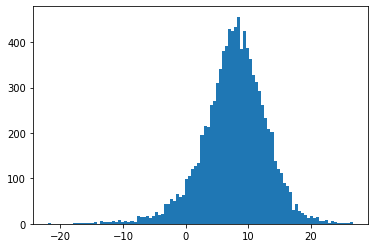

Mean:  6.471765405547228
Median:  7.0268025958357425


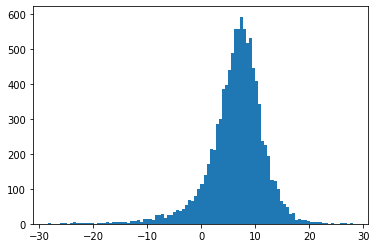

In [26]:
statistic(dataset_df["sdrs_p"])
statistic(dataset_df["sdrs_p_improve"])

## Đánh giá chất lượng của model sử dụng Power-law loss có fine-tune trên data Vin và tập train của ZaloAI

Mean:  6.864980075285385
Median:  7.227899512664765


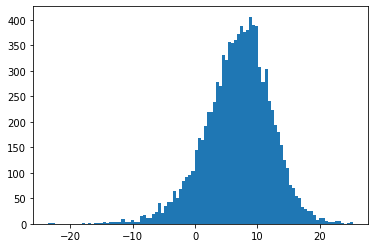

Mean:  5.575557792037636
Median:  6.280609371087456


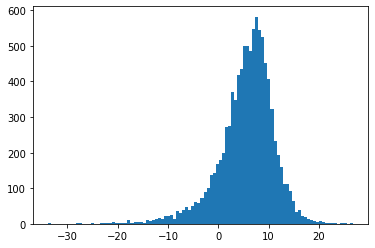

In [27]:
statistic(dataset_df["sdrs_f"])
statistic(dataset_df["sdrs_f_improve"])

## Đánh giá chất lượng của model sử dụng MSE loss gốc

Mean:  3.5331054343339154
Median:  3.8906819306119615


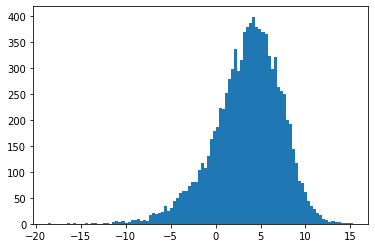

Mean:  2.2436831510861652
Median:  2.743889279783951


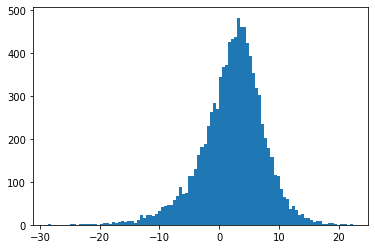

In [28]:
statistic(dataset_df["sdrs_0"])
statistic(dataset_df["sdrs_0_improve"])

## Đánh giá chất lượng của model sử dụng MSE loss gốc (c Tâm train)

Mean:  2.927564513366723
Median:  3.433778293555526


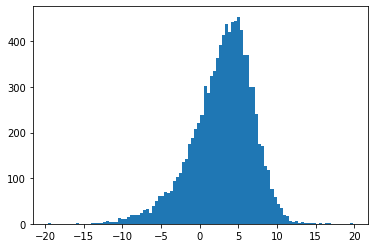

Mean:  1.6381422301189732
Median:  2.1380978196936056


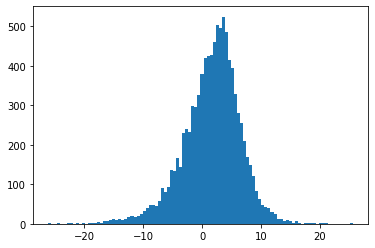

In [29]:
statistic(dataset_df["sdrs_t"])
statistic(dataset_df["sdrs_t_improve"])

## Nghe thử chất lượng audio inference của các model

In [30]:
low_sdr_samples = dataset_df[dataset_df["sdrs_before"] < -15]
low_sdr_samples

,clean_utterance_path,embedding_utterance_path,interference_utterance_path,sdrs_before,sdrs_p,sdrs_p_improve,sdrs_0,sdrs_0_improve,sdrs_t,sdrs_t_improve,sdrs_f,sdrs_f_improve
195,datasets/LibriSpeech/dev-clean/3081/166546/308...,datasets/LibriSpeech/dev-clean/3081/166546/308...,datasets/LibriSpeech/dev-clean/5536/43363/5536...,-17.062285,2.181204,19.243489,2.104759,19.167043,-1.950057,15.112227,0.652571,17.714855
953,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1993/147964/199...,datasets/LibriSpeech/dev-other/6467/56885/6467...,-16.672327,-1.153040,15.519288,-3.587723,13.084604,-5.816503,10.855825,-1.595132,15.077195
1378,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1993/147964/199...,datasets/LibriSpeech/dev-clean/3000/15664/3000...,-16.696972,-1.659493,15.037478,-2.368810,14.328162,-5.257691,11.439281,-2.296432,14.400540
1444,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-other/7641/96670/7641...,-15.542607,1.438443,16.981051,0.695068,16.237675,-3.072920,12.469688,1.351389,16.893997
1735,datasets/LibriSpeech/dev-clean/3081/166546/308...,datasets/LibriSpeech/dev-clean/3081/166546/308...,datasets/LibriSpeech/dev-clean/84/121123/84-12...,-18.301278,-2.784960,15.516318,-5.869127,12.432151,-9.343543,8.957735,-2.490295,15.810982
2103,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1993/147965/199...,datasets/LibriSpeech/dev-clean/1272/141231/127...,-17.125683,4.350612,21.476294,3.844737,20.970420,-1.189340,15.936343,3.905769,21.031451
2164,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1272/141231/127...,-17.243937,-3.135313,14.108623,-2.844971,14.398966,-6.995607,10.248329,-3.247874,13.996063
2455,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1993/147966/199...,datasets/LibriSpeech/dev-clean/8297/275156/829...,-17.138179,3.539130,20.677309,2.092971,19.231150,0.345948,17.484127,3.757958,20.896137
2522,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1993/147966/199...,datasets/LibriSpeech/dev-clean/3000/15664/3000...,-19.625037,-3.731450,15.893587,-4.440913,15.184124,-7.542523,12.082515,-4.832333,14.792704
2731,datasets/LibriSpeech/dev-clean/3081/166546/308...,datasets/LibriSpeech/dev-clean/3081/166546/308...,datasets/LibriSpeech/dev-clean/1673/143397/167...,-15.349170,3.103842,18.453012,-3.547392,11.801777,-11.935078,3.414091,1.938874,17.288044


In [31]:
inference_detail(low_sdr_samples.iloc[0], save=False)
pass

clean_utterance_path           datasets/LibriSpeech/dev-clean/3081/166546/308...
embedding_utterance_path       datasets/LibriSpeech/dev-clean/3081/166546/308...
interference_utterance_path    datasets/LibriSpeech/dev-clean/5536/43363/5536...
sdrs_before                                                           -17.062285
sdrs_p                                                                  2.181204
sdrs_p_improve                                                         19.243489
sdrs_0                                                                  2.104759
sdrs_0_improve                                                         19.167043
sdrs_t                                                                 -1.950057
sdrs_t_improve                                                         15.112227
sdrs_f                                                                  0.652571
sdrs_f_improve                                                         17.714855
Name: 195, dtype: object

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


In [32]:
inference_detail(low_sdr_samples.iloc[1], save=False)
pass

clean_utterance_path           datasets/LibriSpeech/dev-clean/1993/147149/199...
embedding_utterance_path       datasets/LibriSpeech/dev-clean/1993/147964/199...
interference_utterance_path    datasets/LibriSpeech/dev-other/6467/56885/6467...
sdrs_before                                                           -16.672327
sdrs_p                                                                  -1.15304
sdrs_p_improve                                                         15.519288
sdrs_0                                                                 -3.587723
sdrs_0_improve                                                         13.084604
sdrs_t                                                                 -5.816503
sdrs_t_improve                                                         10.855825
sdrs_f                                                                 -1.595132
sdrs_f_improve                                                         15.077195
Name: 953, dtype: object

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


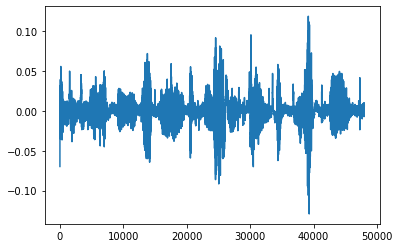

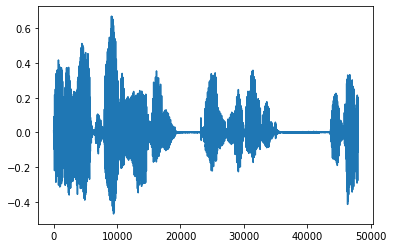

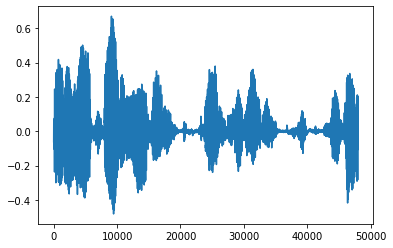

norm 0.7374847412109375


clean_utterance_path           datasets/LibriSpeech/dev-clean/3081/166546/308...
embedding_utterance_path       datasets/LibriSpeech/dev-clean/3081/166546/308...
interference_utterance_path    datasets/LibriSpeech/dev-clean/251/137823/251-...
clean_segment                                                              82426
interference_segment                                                        3877
segment_length                                                                 3
sdrs_before                                                           -16.169469
sdrs_p                                                                   4.59677
sdrs_p_improve                                                         20.766239
sdrs_0                                                                  4.793998
sdrs_0_improve                                                         20.963467
sdrs_t                                                                  0.030318
sdrs_t_improve              

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


In [288]:
inference_detail(low_sdr_samples.iloc[3], save=False)
pass

In [289]:
abnormal_sdr_samples = dataset_df[dataset_df["sdrs_before"] > 20]
abnormal_sdr_samples

,clean_utterance_path,embedding_utterance_path,interference_utterance_path,clean_segment,interference_segment,segment_length,sdrs_before,sdrs_p,sdrs_p_improve,sdrs_0,sdrs_0_improve,sdrs_t,sdrs_t_improve,sdrs_f,sdrs_f_improve
2709,datasets/LibriSpeech/dev-clean/3853/163249/385...,datasets/LibriSpeech/dev-clean/3853/163249/385...,datasets/LibriSpeech/test-clean/237/126133/237...,6616,11093,3,21.074491,16.652866,-4.421625,5.053257,-16.021234,4.059172,-17.015319,22.302700,1.228209
2885,datasets/LibriSpeech/dev-clean/422/122949/422-...,datasets/LibriSpeech/dev-clean/422/122949/422-...,datasets/LibriSpeech/dev-clean/1993/147149/199...,158076,49911,3,20.643107,13.533291,-7.109817,10.500443,-10.142664,5.050371,-15.592736,8.597348,-12.045759
3790,datasets/LibriSpeech/test-clean/4992/23283/499...,datasets/LibriSpeech/test-clean/4992/41797/499...,datasets/LibriSpeech/dev-clean/1993/147149/199...,102129,141669,3,20.580292,22.394502,1.814210,9.268088,-11.312204,5.492752,-15.087540,17.546887,-3.033405
4289,datasets/LibriSpeech/dev-clean/6295/244435/629...,datasets/LibriSpeech/dev-clean/6295/64301/6295...,datasets/LibriSpeech/dev-clean/1993/147149/199...,5584,36268,3,20.013561,15.781250,-4.232311,8.808927,-11.204634,10.657845,-9.355716,14.664653,-5.348908
4776,datasets/LibriSpeech/dev-clean/7850/286674/785...,datasets/LibriSpeech/dev-clean/7850/73752/7850...,datasets/LibriSpeech/dev-clean/1993/147149/199...,65182,109459,3,24.284562,15.925813,-8.358749,6.813703,-17.470859,5.642868,-18.641694,12.513685,-11.770877


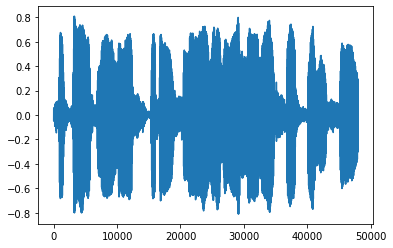

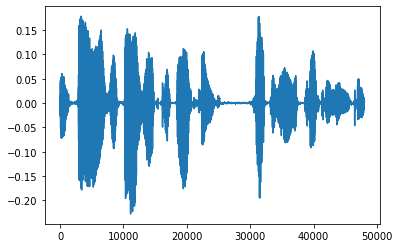

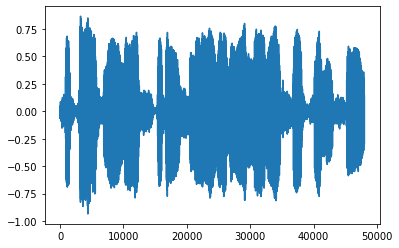

norm 1.0277923583984376


clean_utterance_path           datasets/LibriSpeech/dev-clean/3853/163249/385...
embedding_utterance_path       datasets/LibriSpeech/dev-clean/3853/163249/385...
interference_utterance_path    datasets/LibriSpeech/test-clean/237/126133/237...
clean_segment                                                               6616
interference_segment                                                       11093
segment_length                                                                 3
sdrs_before                                                            21.074491
sdrs_p                                                                 16.652866
sdrs_p_improve                                                         -4.421625
sdrs_0                                                                  5.053257
sdrs_0_improve                                                        -16.021234
sdrs_t                                                                  4.059172
sdrs_t_improve              

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


In [290]:
inference_detail(abnormal_sdr_samples.iloc[0], save=False)
pass

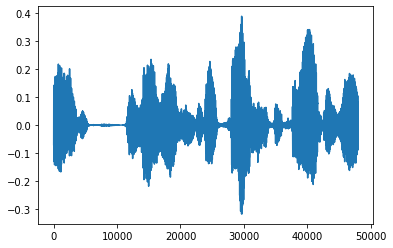

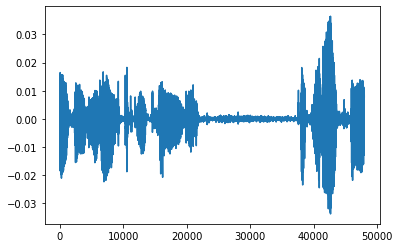

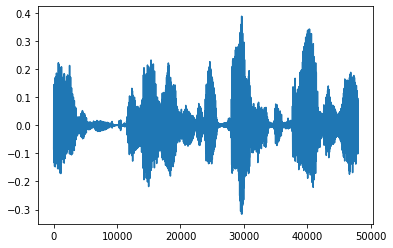

norm 0.42633056640625006


clean_utterance_path           datasets/LibriSpeech/test-clean/4992/23283/499...
embedding_utterance_path       datasets/LibriSpeech/test-clean/4992/41797/499...
interference_utterance_path    datasets/LibriSpeech/dev-clean/1993/147149/199...
clean_segment                                                             102129
interference_segment                                                      141669
segment_length                                                                 3
sdrs_before                                                            20.580292
sdrs_p                                                                 22.394502
sdrs_p_improve                                                           1.81421
sdrs_0                                                                  9.268088
sdrs_0_improve                                                        -11.312204
sdrs_t                                                                  5.492752
sdrs_t_improve              

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


In [291]:
inference_detail(abnormal_sdr_samples.iloc[2], save=False)
pass

In [292]:
p_best_improve_samples = dataset_df[dataset_df["sdrs_p_improve"] > 20]
p_best_improve_samples

,clean_utterance_path,embedding_utterance_path,interference_utterance_path,clean_segment,interference_segment,segment_length,sdrs_before,sdrs_p,sdrs_p_improve,sdrs_0,sdrs_0_improve,sdrs_t,sdrs_t_improve,sdrs_f,sdrs_f_improve
877,datasets/LibriSpeech/dev-clean/3081/166546/308...,datasets/LibriSpeech/dev-clean/3081/166546/308...,datasets/LibriSpeech/dev-clean/251/137823/251-...,82426,3877,3,-16.169469,4.596770,20.766239,4.793998,20.963467,0.030318,16.199787,4.270813,20.440282
1197,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/dev-clean/1993/147149/199...,datasets/LibriSpeech/test-clean/8463/294828/84...,17729,18385,3,-17.277353,2.911165,20.188518,1.291993,18.569346,-4.033445,13.243908,2.655759,19.933111
1374,datasets/LibriSpeech/dev-clean/5895/34622/5895...,datasets/LibriSpeech/dev-clean/5895/34622/5895...,datasets/LibriSpeech/dev-clean/3853/163249/385...,35158,1816,3,-9.601862,10.815806,20.417668,6.799347,16.401209,1.833181,11.435043,7.423272,17.025134
4014,datasets/LibriSpeech/test-clean/5639/40744/563...,datasets/LibriSpeech/test-clean/5639/40744/563...,datasets/LibriSpeech/dev-clean/1462/170138/146...,3809,58443,3,-12.748058,7.325286,20.073344,2.374186,15.122245,-3.656818,9.091240,5.639656,18.387714
4989,datasets/LibriSpeech/dev-clean/2902/9008/2902-...,datasets/LibriSpeech/dev-clean/2902/9006/2902-...,datasets/LibriSpeech/test-clean/672/122797/672...,300514,30379,3,-5.991164,14.668060,20.659224,9.407457,15.398621,5.801758,11.792922,12.561131,18.552295


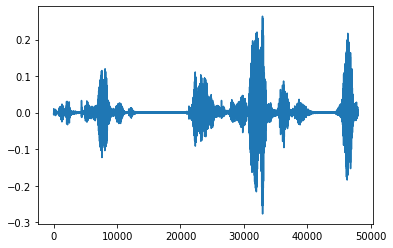

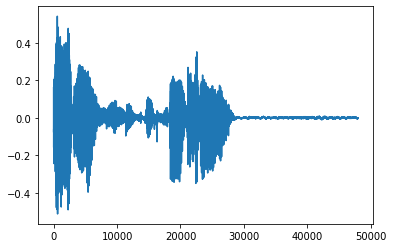

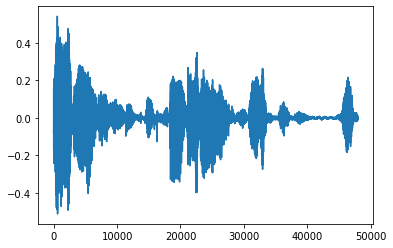

norm 0.596661376953125


clean_utterance_path           datasets/LibriSpeech/dev-clean/2902/9008/2902-...
embedding_utterance_path       datasets/LibriSpeech/dev-clean/2902/9006/2902-...
interference_utterance_path    datasets/LibriSpeech/test-clean/672/122797/672...
clean_segment                                                             300514
interference_segment                                                       30379
segment_length                                                                 3
sdrs_before                                                            -5.991164
sdrs_p                                                                  14.66806
sdrs_p_improve                                                         20.659224
sdrs_0                                                                  9.407457
sdrs_0_improve                                                         15.398621
sdrs_t                                                                  5.801758
sdrs_t_improve              

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


In [293]:
inference_detail(p_best_improve_samples.iloc[-1], save=False)
pass

In [294]:
p_worse_improve_samples = dataset_df[dataset_df["sdrs_p_improve"] < -20]
p_worse_improve_samples

,clean_utterance_path,embedding_utterance_path,interference_utterance_path,clean_segment,interference_segment,segment_length,sdrs_before,sdrs_p,sdrs_p_improve,sdrs_0,sdrs_0_improve,sdrs_t,sdrs_t_improve,sdrs_f,sdrs_f_improve
615,datasets/LibriSpeech/dev-clean/2277/149874/227...,datasets/LibriSpeech/dev-clean/2277/149897/227...,datasets/LibriSpeech/dev-clean/3081/166546/308...,10350,2576,3,14.650216,-8.631629,-23.281845,-2.543897,-17.194113,0.121131,-14.529084,-10.476383,-25.126599
2806,datasets/LibriSpeech/test-clean/260/123288/260...,datasets/LibriSpeech/test-clean/260/123286/260...,datasets/LibriSpeech/dev-clean/2902/9008/2902-...,7771,45788,3,2.927940,-17.150868,-20.078808,3.054061,0.126121,3.744840,0.816900,12.794585,9.866645


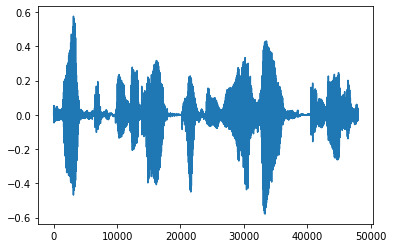

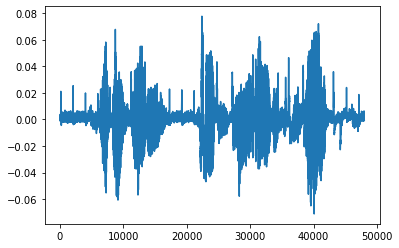

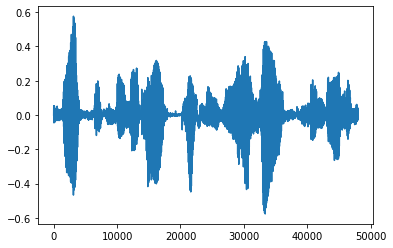

norm 0.634930419921875


clean_utterance_path           datasets/LibriSpeech/dev-clean/2277/149874/227...
embedding_utterance_path       datasets/LibriSpeech/dev-clean/2277/149897/227...
interference_utterance_path    datasets/LibriSpeech/dev-clean/3081/166546/308...
clean_segment                                                              10350
interference_segment                                                        2576
segment_length                                                                 3
sdrs_before                                                            14.650216
sdrs_p                                                                 -8.631629
sdrs_p_improve                                                        -23.281845
sdrs_0                                                                 -2.543897
sdrs_0_improve                                                        -17.194113
sdrs_t                                                                  0.121131
sdrs_t_improve              

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


In [295]:
inference_detail(p_worse_improve_samples.iloc[0], save=False)
pass

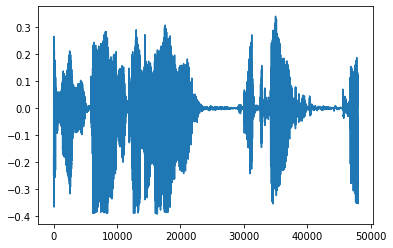

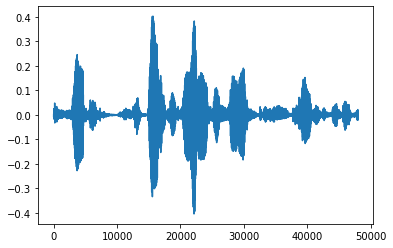

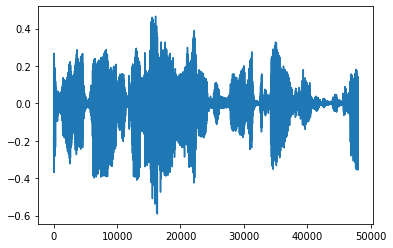

norm 0.650640869140625


clean_utterance_path           datasets/LibriSpeech/test-clean/260/123288/260...
embedding_utterance_path       datasets/LibriSpeech/test-clean/260/123286/260...
interference_utterance_path    datasets/LibriSpeech/dev-clean/2902/9008/2902-...
clean_segment                                                               7771
interference_segment                                                       45788
segment_length                                                                 3
sdrs_before                                                              2.92794
sdrs_p                                                                -17.150868
sdrs_p_improve                                                        -20.078808
sdrs_0                                                                  3.054061
sdrs_0_improve                                                          0.126121
sdrs_t                                                                   3.74484
sdrs_t_improve              

Mixed audio


Target audio


Ref audio


Power-law predict


Power-law fine-tune predict


MSE predict


MSE ms.T predict


In [296]:
inference_detail(p_worse_improve_samples.iloc[1], save=False)
pass